# Signal Processing of the song "The Distance" by Cake

# Introduction

In this project we are going to take the song "The Distance" by the band "Cake" and modify the song with the use of a couple different signal processing techniques. We need to import the song data into python so that it is workable. We then will shorten the song to just the first 30 seconds, take the Fourier Transform of those 30 seconds, apply a filter, take the inverse transform, then plot and play the filtered song. 

The first steps in analyzing "The Distance" with Python are to import the necessary packages. Those packages are `numpy`, `matplotlib`, `scipy`, and for playing the audio back to us inside the Jupyter Notebook `IPython`. We will also use the `copy` package from the standard library.

In [1]:
# Import necessary modules
import numpy as np
from matplotlib import pyplot as plt
from IPython.display import Audio
from scipy.io import wavfile
from copy import deepcopy

Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.


## Gather Data

First we need to gather the data with the `scipy` module. We will use `scipy.io.wavfile` to read the wave file and sort it into 3 sections. The sampling rate, left channel, and right channel. Then we used the `IPython.display.Audio` class to play the first thirty seconds of the song.

In [2]:
# Gather data and play a 30 second segment
song = wavfile.read("TheDistance.wav")
hz = song[0]
dt = 1 / hz
time = np.arange(0, 30, dt)
N = np.size(time)
data = song[1].T
left_channel = data[0][:N]
right_channel = data[1][:N]
channels = [left_channel, right_channel]
Audio(channels, rate=hz)

## Plot the Data

To plot the data we used `matplotlib.pyplot`. The first 30 seconds of each channel are plotted below

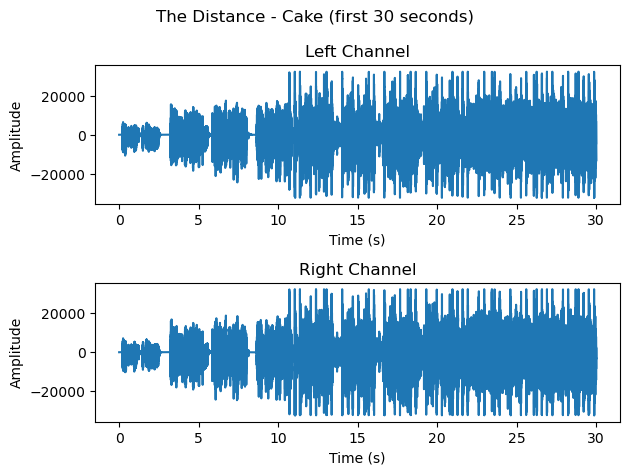

In [3]:
# Plot the data
fig, ax = plt.subplots(2, 1)
for i, v in enumerate(ax):
    v.plot(time, channels[i])
    v.set_xlabel("Time (s)")
    v.set_ylabel("Amplitude")
ax[0].set_title("Left Channel")
ax[1].set_title("Right Channel")
fig.suptitle("The Distance - Cake (first 30 seconds)")
fig.tight_layout()
plt.show()

# Fourier Transform

The discrete Fourier Transform is defined as 

$$F(k) = \sum_{0}^{N-1}f(n)e^{-i2\pi\frac{kn}{N}}$$

An example of the discrete Fourier Transform is shown below. This is a discrete four point Fourier Transform

$$[yay, yay, yay, yay] \supset [4yay, 0, 0, 0]$$

In Python there are several ways to take the Fourier Transform of a set of data. Here we have used the `numpy` package and its various `fft` algorithms. We have plotted the absolute value of the Fourier Transform of each channel below.

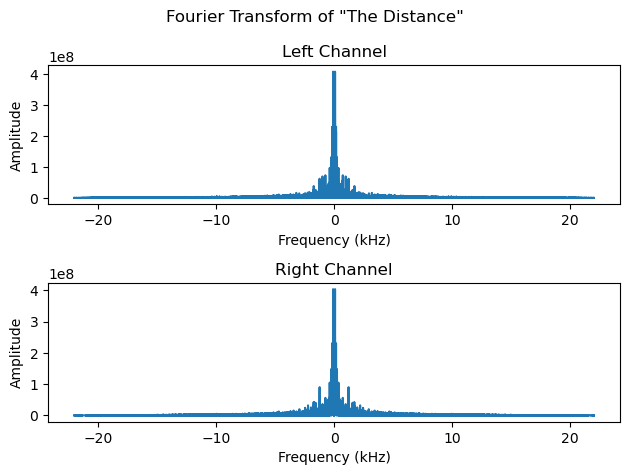

In [4]:
# Take the Fourier Transform of each channel and plot it
freqs = np.linspace(-hz / 2000, hz / 2000, N)
ffts = []
for i in channels:
    ffts.append(np.fft.fftshift(np.fft.fft(i)))

fig, ax = plt.subplots(2, 1)
for i, v in enumerate(ax):
    v.plot(freqs, np.abs(ffts[i]))
    v.set_xlabel("Frequency (kHz)")
    v.set_ylabel("Amplitude")
ax[0].set_title("Left Channel")
ax[1].set_title("Right Channel")
fig.suptitle('Fourier Transform of "The Distance"')
fig.tight_layout()
plt.show()

## Design the Filter

There are several different filters that we could choose to use. A standard rectangle, a Gaussian filter, a Wiener filter and many more. The filter that I chose was a raised cosine filter or also known as a cosine squared filter. This filter has some nice properties. For one it starts at zero and ends at zero which means that there are no sharp edges that can cause some undesired artifacts in the data. It gradually increases in value and at the central value has a maximum amplitude of one then gradually goes back down to zero before the end of the data. 

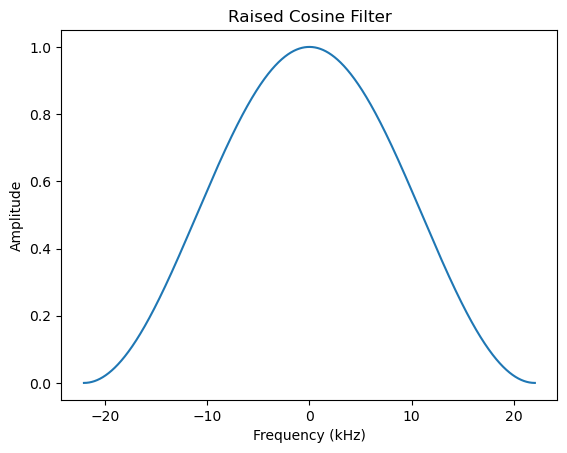

In [5]:
# Design the filter
x = np.linspace(-np.pi / 2, np.pi / 2, N)
cos_filt = np.cos(x) ** 2

# Plot the filter
fig, ax = plt.subplots()
ax.plot(freqs, cos_filt)
ax.set_xlabel("Frequency (kHz)")
ax.set_ylabel("Amplitude")
ax.set_title("Raised Cosine Filter")
plt.show()

## Apply the Filter

To apply the filter to the transformed data we must do term by term multiplication. Python's default array multiplication is term by term so all that there is to do is multiply the two arrays together (making sure that they are the same length of course).

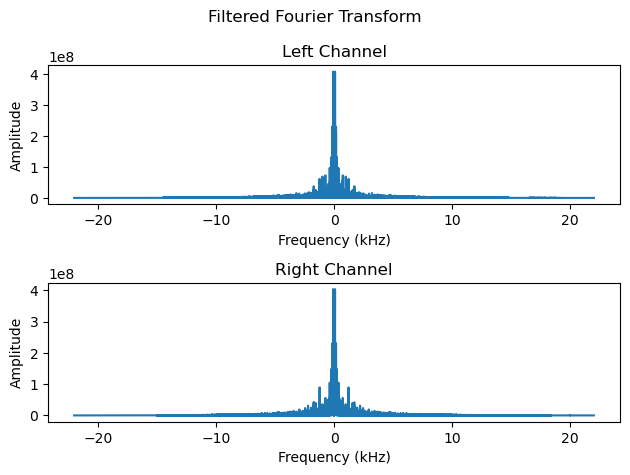

In [6]:
# Apply filter to data
filtered_ffts = deepcopy(ffts)
for i in filtered_ffts:
    i *= cos_filt

# Plot filtered ffts
fig, ax = plt.subplots(2, 1)
for i, v in enumerate(ax):
    v.plot(freqs, np.abs(filtered_ffts[i]))
    v.set_xlabel("Frequency (kHz)")
    v.set_ylabel("Amplitude")
ax[0].set_title("Left Channel")
ax[1].set_title("Right Channel")
fig.suptitle("Filtered Fourier Transform")
fig.tight_layout()
plt.show()

Once the filter has been applied to the data we then take the inverse Fourier Transform of the filtered data then we can plot and play the filtered data

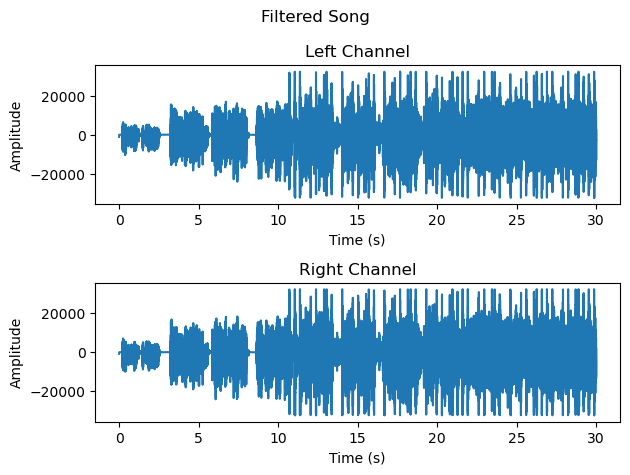

In [7]:
# Inverse Fourier Transform. Plot. Play.
filtered_song = []
for i in filtered_ffts:
    filtered_song.append(np.fft.ifft(np.fft.fftshift(i)).real)

fig, ax = plt.subplots(2, 1)
for i, v in enumerate(ax):
    v.plot(time, filtered_song[i])
    v.set_xlabel("Time (s)")
    v.set_ylabel("Amplitude")
ax[0].set_title("Left Channel")
ax[1].set_title("Right Channel")
fig.suptitle("Filtered Song")
fig.tight_layout()
plt.show()

Audio(filtered_song, rate=hz)

## Modified Filter

The raised cosine filter did not seem to affect the data very much since most of the frequency information is within about 10 kHz. So in order to see (and hear) what the filter does I modified the filter so that the filter removes all frequency information above 2 kHz.

In [8]:
# Make a smaller filter to remove more data and see what happens
# Find subset of indices where the frequency is between -2000 and 2000
cos_filt = np.zeros(N)
start = int(np.where(freqs >= -2)[0][0])
end = int(np.where(freqs >= 2)[0][0])

size = len(cos_filt[start:end])
x = np.linspace(-np.pi / 2, np.pi / 2, size)
cos_filt[start:end] = (np.cos(x)) ** 2

In this case I start with the same size filter. I then find where the frequencies are above -2 kHz and below 2 kHz and use that information to generate the raised cosine filter. Once the filter has been created we can then apply it to the Fourier Transform of the data in the same manner that we did for the first filter.

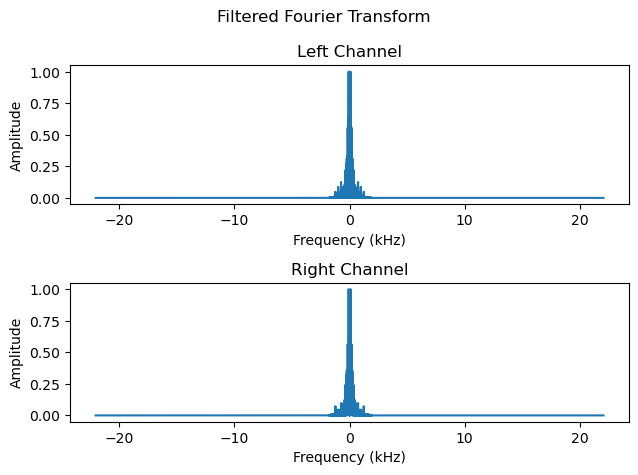

In [9]:
filtered_ffts_2 = deepcopy(ffts)
for i in filtered_ffts_2:
    i *= cos_filt

# Plot filtered ffts
fig, ax = plt.subplots(2, 1)
for i, v in enumerate(ax):
    v.plot(freqs, np.abs(filtered_ffts_2[i]) / np.max(np.abs(filtered_ffts_2[i])))
    # v.plot(freqs, cos_filt)
    v.set_xlabel("Frequency (kHz)")
    v.set_ylabel("Amplitude")
ax[0].set_title("Left Channel")
ax[1].set_title("Right Channel")
fig.suptitle("Filtered Fourier Transform")
fig.tight_layout()
plt.show()

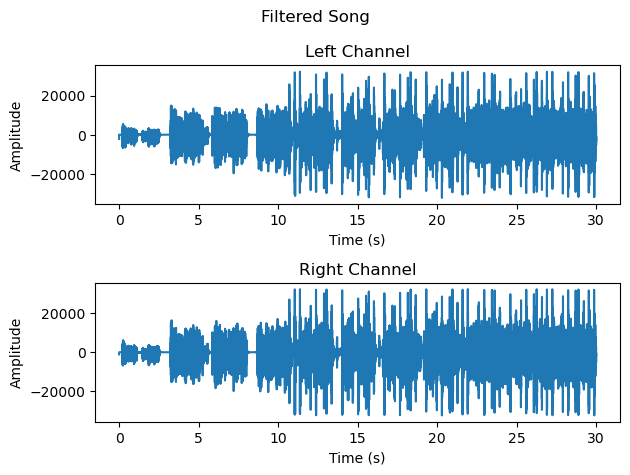

In [10]:
# Inverse Fourier Transform. Plot. Play.
filtered_song_2 = []
for i in filtered_ffts_2:
    filtered_song_2.append(np.fft.ifft(np.fft.fftshift(i)).real)

fig, ax = plt.subplots(2, 1)
for i, v in enumerate(ax):
    v.plot(time, filtered_song_2[i])
    v.set_xlabel("Time (s)")
    v.set_ylabel("Amplitude")
ax[0].set_title("Left Channel")
ax[1].set_title("Right Channel")
fig.suptitle("Filtered Song")
fig.tight_layout()
plt.show()

Audio(filtered_song_2, rate=hz)

Now we can play all three tracks back to back to hear the difference. 

In [11]:
Audio(channels, rate=hz)

In [12]:
Audio(filtered_song, rate=hz)

In [13]:
Audio(filtered_song_2, rate=hz)